In [1]:
%matplotlib inline

import os
import re
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import TextVectorization

from data import load_captions_data, train_val_split
from processing import custom_standardization, make_dataset, decode_and_resize
from models import TransformerEncoderBlock, TransformerDecoderBlock, get_cnn_model, ImageCaptioningModel
from training import LRSchedule, generate_caption

seed = 111
np.random.seed(seed)
tf.random.set_seed(seed)

In [2]:
# Training parameters
AUTOTUNE = tf.data.AUTOTUNE
IMAGES_PATH = "data/Flicker8k_Dataset"
IMAGE_SIZE = (299, 299)
VOCAB_SIZE = 10000
SEQ_LENGTH = 25
EMBED_DIM = 512
FF_DIM = 512
BATCH_SIZE = 64
EPOCHS = 30
ENCODER_HEADS = 1
DECODER_HEADS = 2
DROPOUT = 0.3

In [3]:
# Load the dataset
captions_mapping, text_data = load_captions_data(IMAGES_PATH, "data/Flickr8k.token.txt", SEQ_LENGTH)

# Split the dataset into training and validation sets
train_data, valid_data = train_val_split(captions_mapping)
print("Number of training samples: ", len(train_data))
print("Number of validation samples: ", len(valid_data))

Number of training samples:  6114
Number of validation samples:  1529


In [4]:
vectorization = TextVectorization(
    max_tokens=VOCAB_SIZE,
    output_mode="int",
    output_sequence_length=SEQ_LENGTH,
    standardize=custom_standardization,
)
vectorization.adapt(text_data)

# Pass the list of images and the list of corresponding captions
train_dataset = make_dataset(list(train_data.keys()), list(train_data.values()),
                             IMAGE_SIZE, vectorization,
                             BATCH_SIZE, AUTOTUNE)
valid_dataset = make_dataset(list(valid_data.keys()), list(valid_data.values()),
                             IMAGE_SIZE, vectorization,
                             BATCH_SIZE, AUTOTUNE)

In [5]:
# Only including non data processing hyperparameters
def make_caption_model(EMBED_DIM, FF_DIM, ENCODER_HEADS, DECODER_HEADS, DROPOUT):

    # Data augmentation for image data
    image_augmentation = keras.Sequential(
        [
            layers.RandomFlip("horizontal"),
            layers.RandomRotation(0.2),
            layers.RandomContrast(0.3),     
        ]
    )
    cnn_model = get_cnn_model(IMAGE_SIZE)
    encoder = TransformerEncoderBlock(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=ENCODER_HEADS)
    decoder = TransformerDecoderBlock(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=DECODER_HEADS,
                                      seq_length=SEQ_LENGTH, vocab_size=VOCAB_SIZE, dropout = DROPOUT)
    caption_model = ImageCaptioningModel(cnn_model=cnn_model, encoder=encoder, decoder=decoder,
                                         image_aug=image_augmentation)
    return caption_model

In [6]:
# Create model
caption_model = make_caption_model(EMBED_DIM, FF_DIM, ENCODER_HEADS, DECODER_HEADS, DROPOUT)

# Define the loss function
cross_entropy = keras.losses.SparseCategoricalCrossentropy(
    from_logits=False, reduction="none")

# Create a learning rate schedule
num_train_steps = len(train_dataset) * EPOCHS
num_warmup_steps = num_train_steps // 15
lr_schedule = LRSchedule(post_warmup_learning_rate=1e-4, warmup_steps=num_warmup_steps)

# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule, amsgrad=False), loss=cross_entropy)

Epoch 1/30
96/96 [==============================] - ETA: 0s - loss: 28.1400 - acc: 0.1293

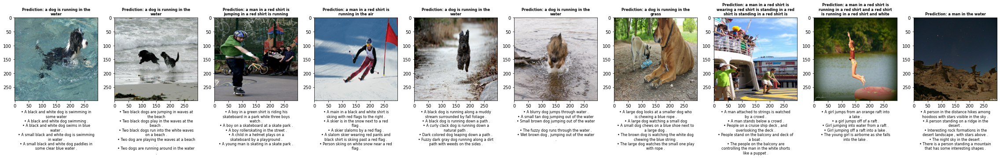

96/96 [==============================] - 59s 459ms/step - loss: 28.1400 - acc: 0.1301 - val_loss: 20.4679 - val_acc: 0.3105
Epoch 2/30
96/96 [==============================] - ETA: 0s - loss: 19.3700 - acc: 0.3186

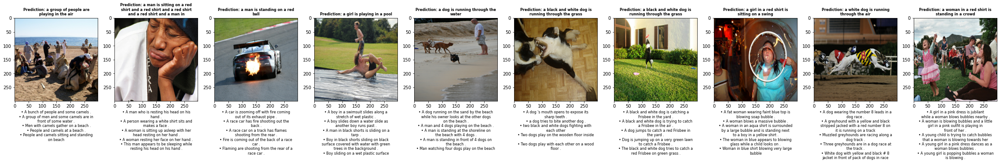

96/96 [==============================] - 38s 393ms/step - loss: 19.3700 - acc: 0.3187 - val_loss: 18.0864 - val_acc: 0.3511
Epoch 3/30
96/96 [==============================] - ETA: 0s - loss: 17.5012 - acc: 0.3546

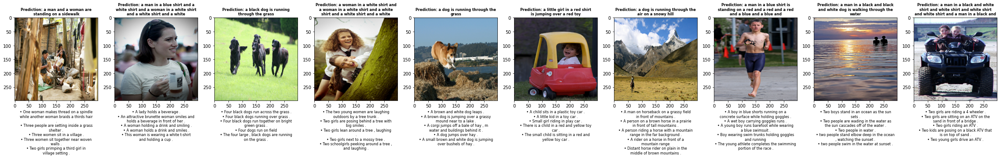

96/96 [==============================] - 38s 393ms/step - loss: 17.5012 - acc: 0.3547 - val_loss: 16.9387 - val_acc: 0.3713
Epoch 4/30
96/96 [==============================] - ETA: 0s - loss: 16.3723 - acc: 0.3771

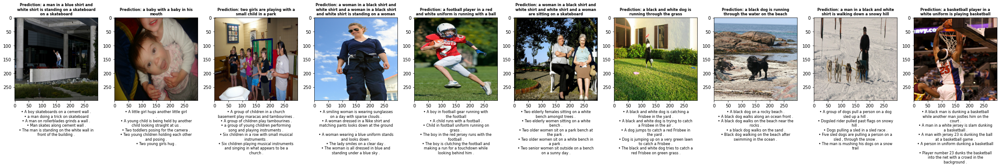

96/96 [==============================] - 38s 390ms/step - loss: 16.3723 - acc: 0.3771 - val_loss: 16.2514 - val_acc: 0.3810
Epoch 5/30
96/96 [==============================] - ETA: 0s - loss: 15.5668 - acc: 0.3911

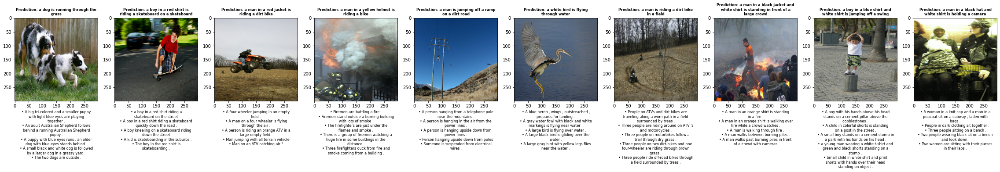

96/96 [==============================] - 38s 391ms/step - loss: 15.5668 - acc: 0.3911 - val_loss: 15.8154 - val_acc: 0.3895
Epoch 6/30
96/96 [==============================] - ETA: 0s - loss: 14.9109 - acc: 0.4028

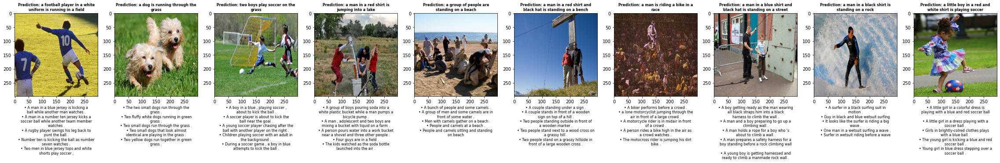

96/96 [==============================] - 38s 393ms/step - loss: 14.9109 - acc: 0.4028 - val_loss: 15.5015 - val_acc: 0.3982
Epoch 7/30
96/96 [==============================] - ETA: 0s - loss: 14.3802 - acc: 0.4155

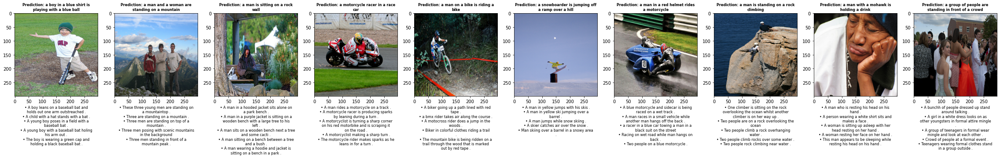

96/96 [==============================] - 38s 394ms/step - loss: 14.3802 - acc: 0.4155 - val_loss: 15.2825 - val_acc: 0.4035
Epoch 8/30
96/96 [==============================] - ETA: 0s - loss: 13.9031 - acc: 0.4267

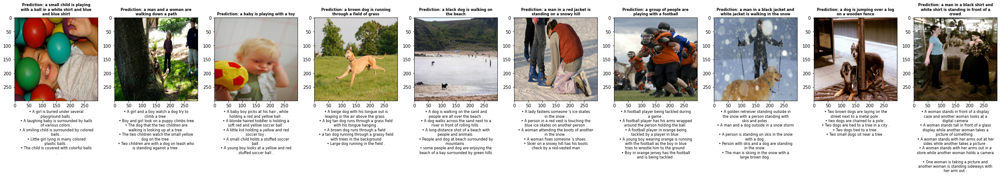

96/96 [==============================] - 37s 389ms/step - loss: 13.9031 - acc: 0.4267 - val_loss: 15.0861 - val_acc: 0.4071
Epoch 9/30
96/96 [==============================] - ETA: 0s - loss: 13.4994 - acc: 0.4332

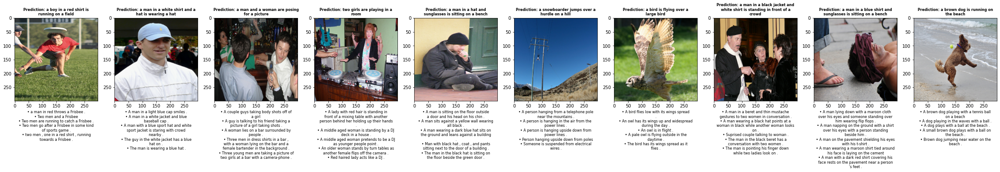

96/96 [==============================] - 38s 396ms/step - loss: 13.4994 - acc: 0.4332 - val_loss: 14.9828 - val_acc: 0.4101
Epoch 10/30
96/96 [==============================] - ETA: 0s - loss: 13.1286 - acc: 0.4411

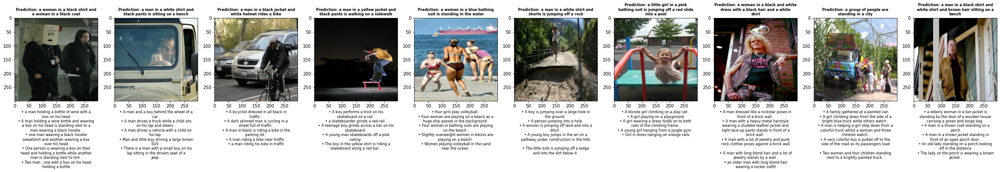

96/96 [==============================] - 38s 394ms/step - loss: 13.1286 - acc: 0.4410 - val_loss: 14.9370 - val_acc: 0.4114
Epoch 11/30
96/96 [==============================] - ETA: 0s - loss: 12.7715 - acc: 0.4499

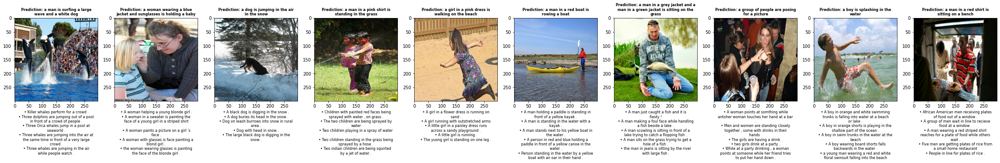

96/96 [==============================] - 38s 392ms/step - loss: 12.7715 - acc: 0.4499 - val_loss: 14.9224 - val_acc: 0.4128
Epoch 12/30
96/96 [==============================] - ETA: 0s - loss: 12.4442 - acc: 0.4542

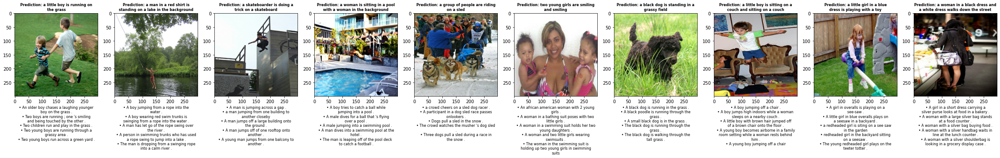

96/96 [==============================] - 38s 395ms/step - loss: 12.4442 - acc: 0.4542 - val_loss: 14.8798 - val_acc: 0.4143
Epoch 13/30
96/96 [==============================] - ETA: 0s - loss: 12.1557 - acc: 0.4639

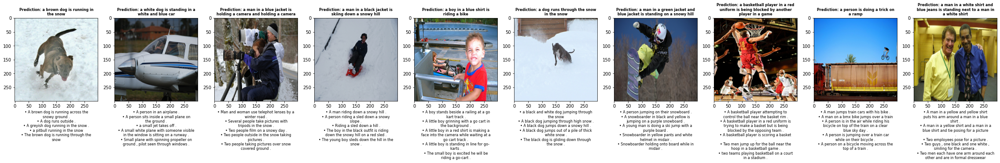

96/96 [==============================] - 39s 400ms/step - loss: 12.1557 - acc: 0.4639 - val_loss: 14.8636 - val_acc: 0.4146
Epoch 14/30
96/96 [==============================] - ETA: 0s - loss: 11.8907 - acc: 0.4741

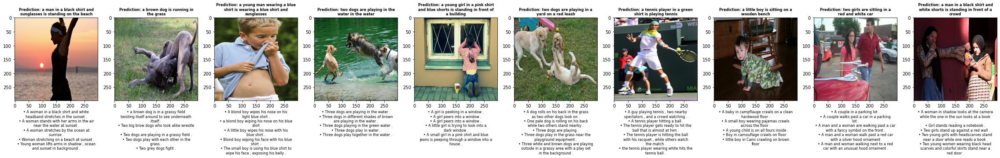

96/96 [==============================] - 38s 389ms/step - loss: 11.8907 - acc: 0.4740 - val_loss: 14.8954 - val_acc: 0.4147
Epoch 15/30
96/96 [==============================] - ETA: 0s - loss: 11.6108 - acc: 0.4759

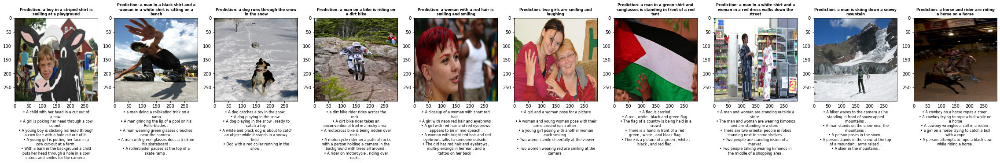

96/96 [==============================] - 38s 394ms/step - loss: 11.6108 - acc: 0.4759 - val_loss: 14.9086 - val_acc: 0.4141
Epoch 16/30
96/96 [==============================] - ETA: 0s - loss: 11.3481 - acc: 0.4858

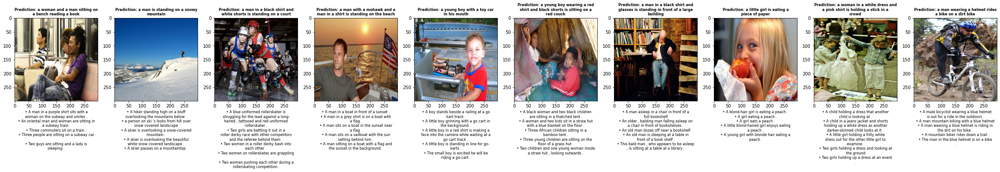

96/96 [==============================] - 38s 393ms/step - loss: 11.3481 - acc: 0.4857 - val_loss: 14.8935 - val_acc: 0.4131
Epoch 17/30
96/96 [==============================] - ETA: 0s - loss: 11.0971 - acc: 0.4925

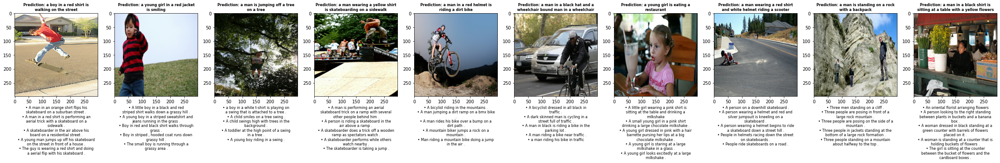

96/96 [==============================] - 38s 392ms/step - loss: 11.0971 - acc: 0.4924 - val_loss: 15.0002 - val_acc: 0.4138


In [7]:
# Callback to vieww values after each epoch
class EvaluateCaptions(keras.callbacks.Callback):
    def on_test_end(self, epoch, logs=None):
        generate_caption(self.model, vectorization, valid_data = valid_data,
                         seq_length = SEQ_LENGTH, image_size = IMAGE_SIZE, samples = 10)
# EarlyStopping criteria
early_stopping = keras.callbacks.EarlyStopping(monitor='val_acc', patience=3, restore_best_weights=True)

# Fit the model
out = caption_model.fit(
    train_dataset,
    epochs = EPOCHS, 
    validation_data=valid_dataset,
    callbacks=[early_stopping, EvaluateCaptions()],
)

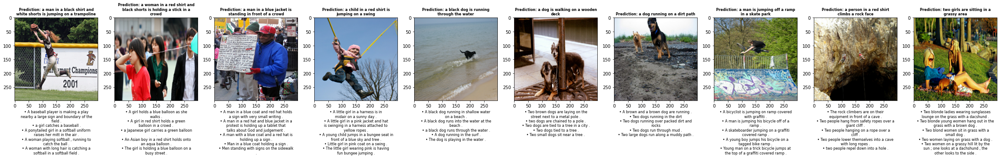

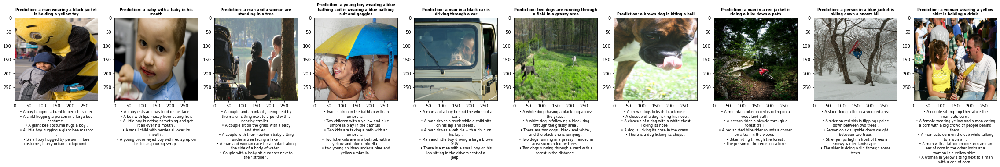

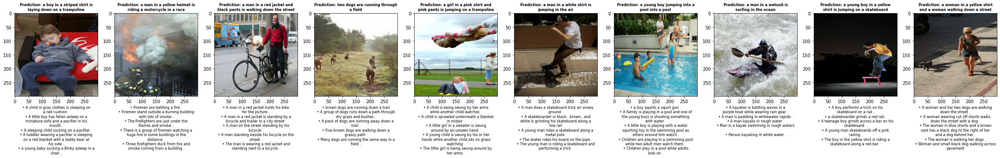

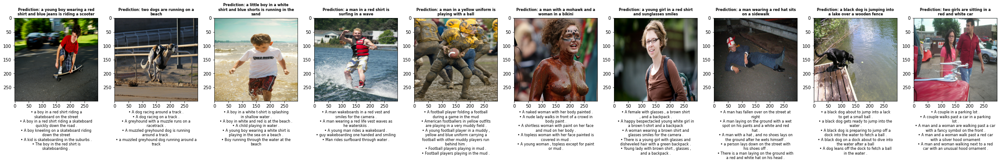

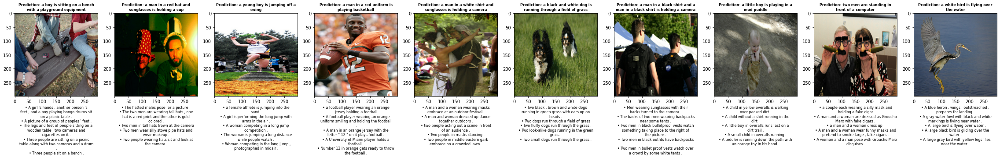

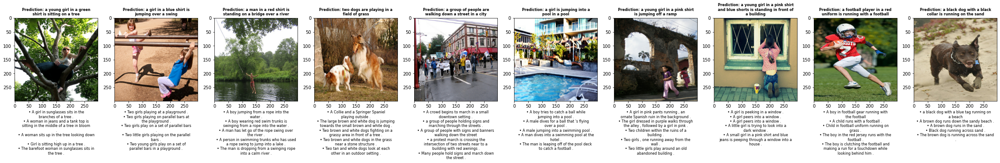

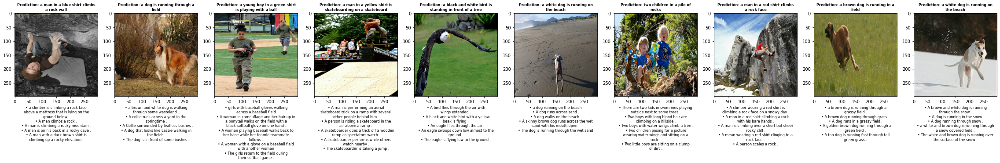

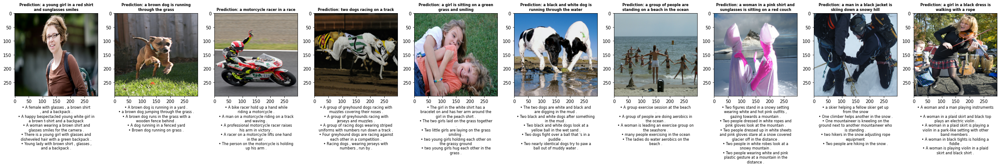

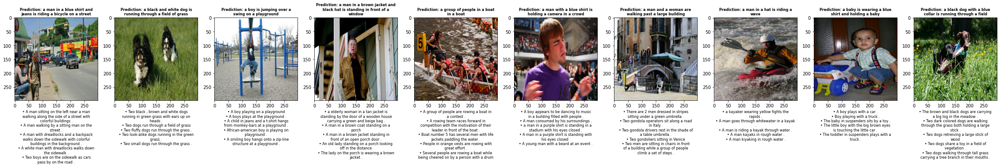

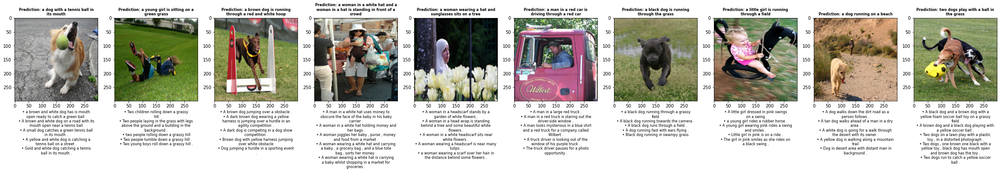

In [12]:
for _ in range(10):
    generate_caption(caption_model, vectorization, valid_data = valid_data,
                     seq_length = SEQ_LENGTH, image_size = IMAGE_SIZE, samples = 10)